# Modeling

In [1]:
from sklearn import metrics
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_absolute_error as mae, r2_score as r2
from scipy.stats import uniform, randint

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pickle
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(y_test, y_pred, X):
    
    y_test = target_transformer.inverse_transform(y_test)
    y_pred = target_transformer.inverse_transform(pd.Series(y_pred))

    mse1 = mse(y_test, y_pred)

    rmse1 = rmse(y_test, y_pred)

    mae1 = mae(y_test, y_pred)

    medae1 = medae(y_test, y_pred)

    R21 = R2(y_test, y_pred)
    
    adj_r2 = 1 - (1-r2(y_test, y_pred)) * (len(y)-1)/(len(y)-X.shape[1]-1)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}\nAdj_R2:  {}".format(mse1, rmse1, R21, mae1, medae1, adj_r2))
    print('-'*30)


def get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png'):
    imp = cat_model.get_feature_importance(data=train_dataset)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=cat_model.feature_names_)
    axes.set_title(title)
    if save_fig:
        plt.savefig(file_name)
    plt.show()
    

def draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution'):
    plt.figure(figsize=(12, 5))
    sns.distplot(y_test)
    sns.distplot(y_pred)
    plt.legend(['test', 'pred'])
    if save_fig:
        plt.savefig(file_name)
    plt.show()

    
def draw_residuals(y_test, y_pred, save_fig=False,
                   file_name='cat_residuals.png'):
    y_test = target_transformer.inverse_transform(y_test)
    y_pred = target_transformer.inverse_transform(pd.Series(y_pred))  / MULTIPLIER
    sns.residplot(x=y_test, y=y_pred)
    if save_fig:
        plt.savefig(file_name)
    plt.show()
    
    
class TargetTransformer:
    def __init__(self, denominator=1):
        self.scale = denominator
        
    def inverse_transform(self, feature):
        return feature.apply(lambda x: np.expm1(x))
    
    def transform(self, feature):
        return feature.apply(lambda x: np.log1p(x))
    
target_transformer = TargetTransformer()

# 3 Min count 2

In [85]:
with open('dataset_2.pkl', 'rb') as f:
    df_pr = pickle.load(f)

In [86]:
df_pr.head()

,age_access_type,average_rating,duration,type,name,release_year,target,subscription_only,uid,actor_0,...,director_0,director_1,director_2,director_3,director_4,director_5,SUBSCRIPTION,DTO,RENT,AVOD
0,18,4.00,15.607270,MOVIE,В поисках древнего артефакта,2019,0.000004,0,11ba66db-e941-4c3a-8da6-d8900e56f8c7,-0.048132,...,0.146553,0.086444,0.181065,-0.175414,0.169276,0.104724,1,1,1,0
1,18,6.99,15.145235,MOVIE,Прожарка Чарли Шина,2011,0.000354,1,3f30a2ef-53b7-40e3-954f-1bdfc38a6d17,-0.063862,...,-0.096604,0.208678,0.257821,-0.084255,0.145304,0.262974,1,0,0,0
2,18,6.00,15.145235,MOVIE,Прожарка Уильяма Шэтнера,2006,0.000064,1,cdfa700f-122d-41e5-b8dc-9c6813bab6d2,-0.094405,...,-0.096604,0.208678,0.257821,-0.084255,0.145304,0.262974,1,0,0,0
3,0,6.21,15.396549,MOVIE,Большое путешествие,2006,0.000003,1,d8b55146-dee5-4498-957c-5614414b48fb,-0.079006,...,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0,0
4,6,6.40,15.523889,MOVIE,Пламенное сердце,2022,0.009705,1,ba6bec1a-3aa9-48c7-aa65-908c21627a12,-0.023747,...,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0,0


In [87]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT', 'release_year']
num_features = ['age_access_type', 'average_rating', 'duration',
               'actor_0', 'actor_1', 'actor_2', 'actor_3', 'actor_4', 'actor_5',
                'country_0','country_1', 'country_2','country_3', 'country_4', 'country_5',
                'genre_0', 'genre_1', 'genre_2', 'genre_3', 'genre_4', 'genre_5',
                'director_0', 'director_1', 'director_2', 'director_3', 'director_4']

In [88]:
df_pr[cat_features]

,type,subscription_only,SUBSCRIPTION,AVOD,DTO,RENT,release_year
0,MOVIE,0,1,0,1,1,2019
1,MOVIE,1,1,0,0,0,2011
2,MOVIE,1,1,0,0,0,2006
3,MOVIE,1,1,0,0,0,2006
4,MOVIE,1,1,0,0,0,2022
...,...,...,...,...,...,...,...
9478,SERIAL,0,1,0,1,0,2015
9479,SERIAL,1,1,0,0,0,2022
9480,SERIAL,0,1,1,0,0,2020
9481,SERIAL,1,1,0,0,0,2020


In [89]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

In [90]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        )
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


## Training

In [91]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features,
    'iterations': 10000, 
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=50,
    verbose=100,
    plot=False
)



Learning rate set to 0.017502
0:	learn: 0.0426931	test: 0.0483635	best: 0.0483635 (0)	total: 5.75ms	remaining: 57.5s
100:	learn: 0.0337481	test: 0.0391391	best: 0.0391391 (100)	total: 457ms	remaining: 44.8s
200:	learn: 0.0311778	test: 0.0370696	best: 0.0370696 (200)	total: 913ms	remaining: 44.5s
300:	learn: 0.0300111	test: 0.0364308	best: 0.0364226 (291)	total: 1.36s	remaining: 43.9s
400:	learn: 0.0293395	test: 0.0360140	best: 0.0360129 (399)	total: 1.79s	remaining: 42.9s
500:	learn: 0.0288641	test: 0.0356801	best: 0.0356801 (500)	total: 2.21s	remaining: 42s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.03559012137
bestIteration = 543

Shrink model to first 544 iterations.


In [47]:
# cat_model = cat.CatBoostRegressor(**cat_params)
# cat_model.load_model('3')

In [94]:
cat_model.save_model('3')

In [92]:
y_pred = cat_model.predict(X_test)

In [93]:
calc_metrics(y_test, y_pred, X)

*** VAL **: 
MSE:   0.012653848539055351
RMSE:  0.11248932633390313
R2:    0.33550150433942316
MAE:   0.036919673892166535
MedAE: 0.011563431458878075
Adj_R2:  0.333110210007029
------------------------------


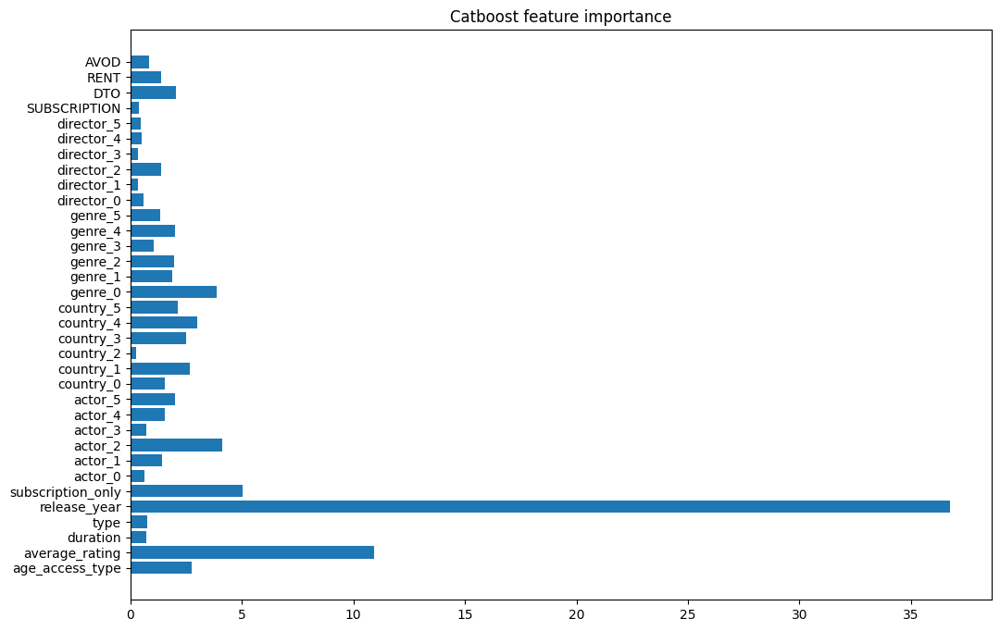

In [95]:
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')

/tmp/ipykernel_2331/168675531.py:68: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test)
/tmp/ipykernel_2331/168675531.py:69: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_pred)


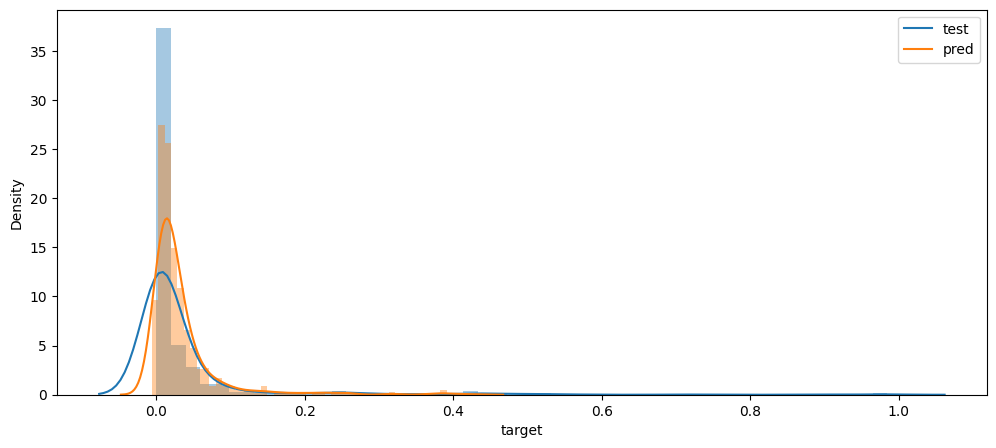

In [96]:
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')

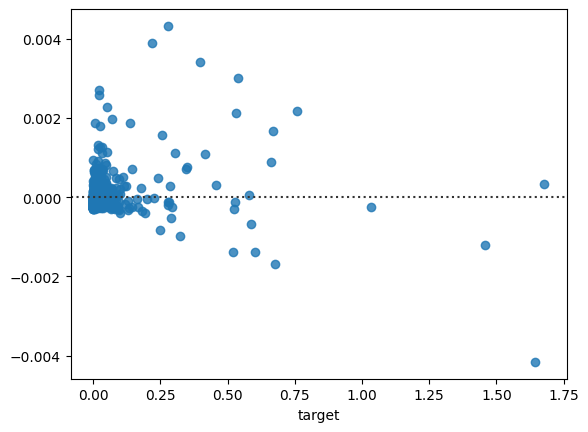

In [97]:
draw_residuals(y_test, y_pred, save_fig=False)

In [98]:
len(y_pred[y_pred <= 0])

29

# 3_1 drop release_year min count 2

In [99]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT']

In [100]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid', 'release_year'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

In [101]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        )
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


## Training

In [102]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features,
    'iterations': 10000, 
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=50,
    verbose=100,
    plot=False
)

Learning rate set to 0.017502
0:	learn: 0.0428599	test: 0.0485675	best: 0.0485675 (0)	total: 5.72ms	remaining: 57.2s
100:	learn: 0.0398794	test: 0.0456027	best: 0.0456027 (100)	total: 432ms	remaining: 42.4s
200:	learn: 0.0386695	test: 0.0446303	best: 0.0446303 (200)	total: 862ms	remaining: 42s
300:	learn: 0.0379239	test: 0.0441756	best: 0.0441752 (299)	total: 1.29s	remaining: 41.7s
400:	learn: 0.0372322	test: 0.0437552	best: 0.0437446 (399)	total: 1.73s	remaining: 41.4s
500:	learn: 0.0366500	test: 0.0435841	best: 0.0435839 (499)	total: 2.15s	remaining: 40.8s
600:	learn: 0.0359762	test: 0.0430910	best: 0.0430910 (600)	total: 2.59s	remaining: 40.5s
700:	learn: 0.0354398	test: 0.0428583	best: 0.0428583 (700)	total: 3.04s	remaining: 40.3s
800:	learn: 0.0349856	test: 0.0426376	best: 0.0426272 (797)	total: 3.49s	remaining: 40.1s
900:	learn: 0.0345388	test: 0.0425164	best: 0.0424880 (869)	total: 3.93s	remaining: 39.7s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.0424879

In [106]:
cat_model.save_model('3_1')

In [103]:
y_pred = cat_model.predict(X_test)

In [104]:
calc_metrics(y_test, y_pred, X)

*** VAL **: 
MSE:   0.017073514765385846
RMSE:  0.13066566023782164
R2:    0.10340914527142708
MAE:   0.044823752154475115
MedAE: 0.021434348872741055
Adj_R2:  0.1002778617275556
------------------------------


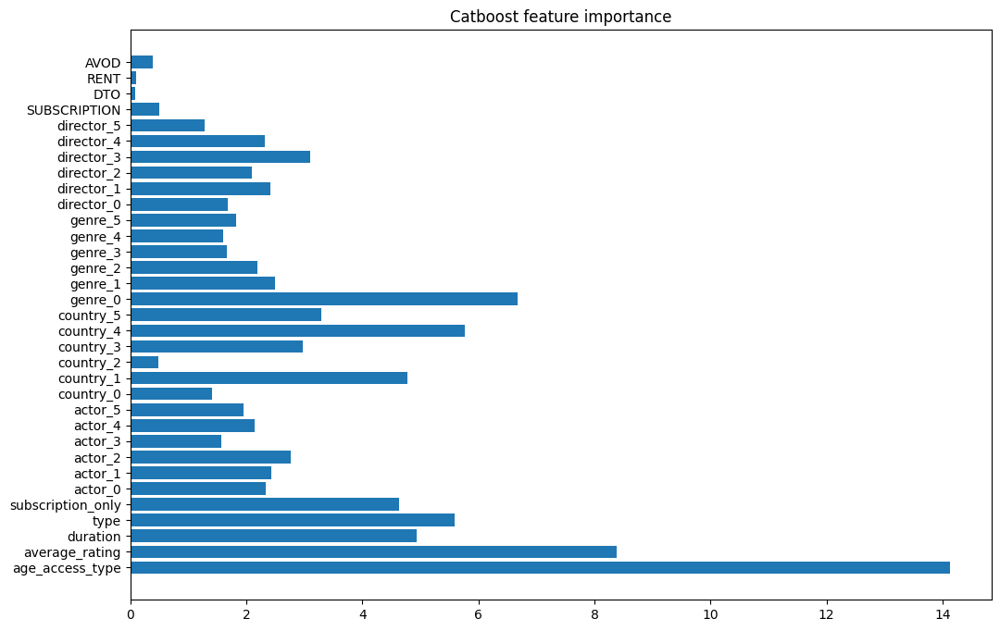

In [105]:
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')

/tmp/ipykernel_2331/168675531.py:68: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test)
/tmp/ipykernel_2331/168675531.py:69: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_pred)


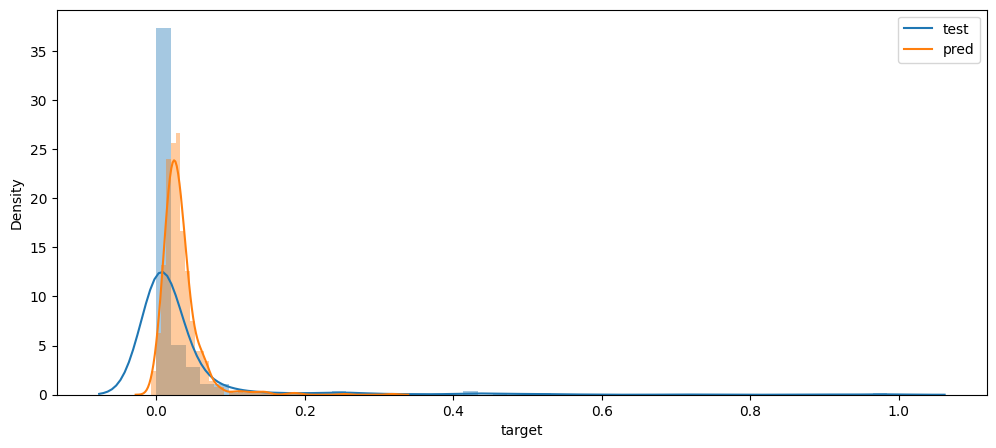

In [107]:
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')

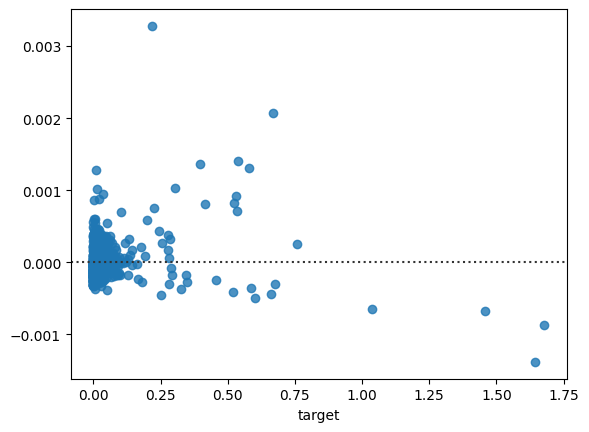

In [108]:
draw_residuals(y_test, y_pred, save_fig=False)

In [109]:
len(y_pred[y_pred <= 0])

12

## Tuning

In [147]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT', 'release_year']

In [148]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        ) 
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


In [149]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 100,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [150]:
parameters_distr = {'depth': randint(5, 10),
                    'learning_rate': uniform(0.01, 0.3),
                    'iterations': randint(500, 10000),
                    'l2_leaf_reg':  uniform(0.01, 0.5)
                     }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, scoring='neg_mean_squared_error', 
                          cv=3, n_jobs=10, verbose=1)

grid.fit(X_train, y_train)

cat_model = grid.best_estimator_
cat_model.save_model('3_finetuned')

Fitting 3 folds for each of 10 candidates, totalling 30 fits


/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, emb

0:	learn: 0.0412891	total: 232ms	remaining: 6m 8s
1:	learn: 0.0404872	total: 368ms	remaining: 4m 51s
2:	learn: 0.0398187	total: 408ms	remaining: 3m 35s
3:	learn: 0.0392179	total: 427ms	remaining: 2m 49s
4:	learn: 0.0386048	total: 529ms	remaining: 2m 47s
5:	learn: 0.0381069	total: 575ms	remaining: 2m 31s
6:	learn: 0.0376773	total: 772ms	remaining: 2m 54s
7:	learn: 0.0372461	total: 958ms	remaining: 3m 9s
8:	learn: 0.0368394	total: 1.23s	remaining: 3m 36s
9:	learn: 0.0364692	total: 1.3s	remaining: 3m 25s
10:	learn: 0.0360905	total: 1.49s	remaining: 3m 33s
11:	learn: 0.0357995	total: 1.65s	remaining: 3m 36s
12:	learn: 0.0355256	total: 1.81s	remaining: 3m 39s
13:	learn: 0.0352374	total: 1.96s	remaining: 3m 40s
14:	learn: 0.0349800	total: 2.41s	remaining: 4m 12s
15:	learn: 0.0346977	total: 3.09s	remaining: 5m 3s
16:	learn: 0.0344962	total: 3.74s	remaining: 5m 46s
17:	learn: 0.0342422	total: 4.06s	remaining: 5m 54s
18:	learn: 0.0340160	total: 4.75s	remaining: 6m 32s
19:	learn: 0.0338032	total

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


1523:	learn: 0.0099430	total: 7m 26s	remaining: 18.8s
1524:	learn: 0.0099362	total: 7m 27s	remaining: 18.5s
1525:	learn: 0.0099286	total: 7m 27s	remaining: 18.2s
1526:	learn: 0.0099204	total: 7m 27s	remaining: 17.9s
1527:	learn: 0.0099086	total: 7m 28s	remaining: 17.6s
1528:	learn: 0.0098996	total: 7m 28s	remaining: 17.3s
1529:	learn: 0.0098941	total: 7m 28s	remaining: 17s
1530:	learn: 0.0098804	total: 7m 28s	remaining: 16.7s
1531:	learn: 0.0098764	total: 7m 28s	remaining: 16.4s
1532:	learn: 0.0098718	total: 7m 29s	remaining: 16.1s
1533:	learn: 0.0098658	total: 7m 29s	remaining: 15.8s
1534:	learn: 0.0098613	total: 7m 29s	remaining: 15.5s
1535:	learn: 0.0098551	total: 7m 29s	remaining: 15.2s
1536:	learn: 0.0098504	total: 7m 29s	remaining: 14.9s
1537:	learn: 0.0098439	total: 7m 30s	remaining: 14.6s
1538:	learn: 0.0098413	total: 7m 30s	remaining: 14.3s
1539:	learn: 0.0098360	total: 7m 30s	remaining: 14s
1540:	learn: 0.0098301	total: 7m 31s	remaining: 13.8s
1541:	learn: 0.0098190	total: 7m

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


753:	learn: 0.0022965	total: 9m 31s	remaining: 25m 37s
754:	learn: 0.0022878	total: 9m 33s	remaining: 25m 38s
755:	learn: 0.0022793	total: 9m 33s	remaining: 25m 37s
756:	learn: 0.0022745	total: 9m 34s	remaining: 25m 36s
757:	learn: 0.0022694	total: 9m 35s	remaining: 25m 36s
758:	learn: 0.0022612	total: 9m 36s	remaining: 25m 35s
759:	learn: 0.0022536	total: 9m 37s	remaining: 25m 36s
760:	learn: 0.0022487	total: 9m 38s	remaining: 25m 35s
761:	learn: 0.0022409	total: 9m 39s	remaining: 25m 34s
762:	learn: 0.0022330	total: 9m 39s	remaining: 25m 33s
763:	learn: 0.0022236	total: 9m 40s	remaining: 25m 32s
764:	learn: 0.0022185	total: 9m 41s	remaining: 25m 32s
765:	learn: 0.0022119	total: 9m 42s	remaining: 25m 32s
766:	learn: 0.0022066	total: 9m 43s	remaining: 25m 31s
767:	learn: 0.0022014	total: 9m 43s	remaining: 25m 30s
768:	learn: 0.0021929	total: 9m 44s	remaining: 25m 29s
769:	learn: 0.0021852	total: 9m 45s	remaining: 25m 29s
770:	learn: 0.0021770	total: 9m 46s	remaining: 25m 28s
771:	learn

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


1406:	learn: 0.0001282	total: 17m 36s	remaining: 1h 33m 33s
1407:	learn: 0.0001278	total: 17m 37s	remaining: 1h 33m 35s
1408:	learn: 0.0001275	total: 17m 38s	remaining: 1h 33m 35s
1409:	learn: 0.0001272	total: 17m 39s	remaining: 1h 33m 34s
1410:	learn: 0.0001268	total: 17m 39s	remaining: 1h 33m 31s
1411:	learn: 0.0001264	total: 17m 40s	remaining: 1h 33m 32s
1412:	learn: 0.0001257	total: 17m 41s	remaining: 1h 33m 31s
1413:	learn: 0.0001255	total: 17m 41s	remaining: 1h 33m 28s
1414:	learn: 0.0001252	total: 17m 42s	remaining: 1h 33m 26s
1415:	learn: 0.0001251	total: 17m 42s	remaining: 1h 33m 24s
1416:	learn: 0.0001248	total: 17m 43s	remaining: 1h 33m 24s
1417:	learn: 0.0001246	total: 17m 44s	remaining: 1h 33m 22s
1418:	learn: 0.0001244	total: 17m 44s	remaining: 1h 33m 20s
1419:	learn: 0.0001240	total: 17m 45s	remaining: 1h 33m 21s
1420:	learn: 0.0001238	total: 17m 46s	remaining: 1h 33m 19s
1421:	learn: 0.0001237	total: 17m 46s	remaining: 1h 33m 18s
1422:	learn: 0.0001234	total: 17m 47s	re

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2200:	learn: 0.0020035	total: 10m 55s	remaining: 32.5s
2201:	learn: 0.0020011	total: 10m 56s	remaining: 32.2s
2202:	learn: 0.0019989	total: 10m 56s	remaining: 31.9s
2203:	learn: 0.0019967	total: 10m 56s	remaining: 31.6s
2204:	learn: 0.0019953	total: 10m 57s	remaining: 31.3s
2205:	learn: 0.0019948	total: 10m 57s	remaining: 31s
2206:	learn: 0.0019928	total: 10m 57s	remaining: 30.7s
2207:	learn: 0.0019913	total: 10m 57s	remaining: 30.4s
2208:	learn: 0.0019875	total: 10m 57s	remaining: 30.1s
2209:	learn: 0.0019862	total: 10m 58s	remaining: 29.8s
2210:	learn: 0.0019840	total: 10m 58s	remaining: 29.5s
2211:	learn: 0.0019828	total: 10m 59s	remaining: 29.2s
2212:	learn: 0.0019817	total: 10m 59s	remaining: 28.9s
2213:	learn: 0.0019800	total: 11m	remaining: 28.6s
2214:	learn: 0.0019773	total: 11m	remaining: 28.3s
2215:	learn: 0.0019753	total: 11m	remaining: 28s
2216:	learn: 0.0019735	total: 11m	remaining: 27.7s
2217:	learn: 0.0019705	total: 11m	remaining: 27.4s
2218:	learn: 0.0019681	total: 11m 

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2647:	learn: 0.0000320	total: 33m 7s	remaining: 1m 39s
2648:	learn: 0.0000320	total: 33m 8s	remaining: 1m 39s
2649:	learn: 0.0000320	total: 33m 9s	remaining: 1m 38s
2650:	learn: 0.0000319	total: 33m 10s	remaining: 1m 37s
2651:	learn: 0.0000319	total: 33m 11s	remaining: 1m 36s
2652:	learn: 0.0000318	total: 33m 12s	remaining: 1m 36s
2653:	learn: 0.0000317	total: 33m 12s	remaining: 1m 35s
2654:	learn: 0.0000317	total: 33m 13s	remaining: 1m 34s
2655:	learn: 0.0000317	total: 33m 14s	remaining: 1m 33s
2656:	learn: 0.0000316	total: 33m 14s	remaining: 1m 33s
2657:	learn: 0.0000315	total: 33m 15s	remaining: 1m 32s
2658:	learn: 0.0000315	total: 33m 16s	remaining: 1m 31s
2659:	learn: 0.0000314	total: 33m 16s	remaining: 1m 30s
2660:	learn: 0.0000314	total: 33m 17s	remaining: 1m 30s
2661:	learn: 0.0000313	total: 33m 18s	remaining: 1m 29s
2662:	learn: 0.0000312	total: 33m 19s	remaining: 1m 28s
2663:	learn: 0.0000312	total: 33m 19s	remaining: 1m 27s
2664:	learn: 0.0000311	total: 33m 20s	remaining: 1m

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2037:	learn: 0.0000235	total: 25m 34s	remaining: 1h 6m 3s
2038:	learn: 0.0000234	total: 25m 35s	remaining: 1h 6m 2s
2039:	learn: 0.0000234	total: 25m 35s	remaining: 1h 6m 1s
2040:	learn: 0.0000233	total: 25m 36s	remaining: 1h 6m 1s
2041:	learn: 0.0000232	total: 25m 37s	remaining: 1h 6m
2042:	learn: 0.0000232	total: 25m 37s	remaining: 1h 5m 58s
2043:	learn: 0.0000231	total: 25m 38s	remaining: 1h 5m 58s
2044:	learn: 0.0000229	total: 25m 39s	remaining: 1h 5m 57s
2045:	learn: 0.0000229	total: 25m 40s	remaining: 1h 5m 56s
2046:	learn: 0.0000229	total: 25m 40s	remaining: 1h 5m 55s
2047:	learn: 0.0000228	total: 25m 41s	remaining: 1h 5m 55s
2048:	learn: 0.0000228	total: 25m 42s	remaining: 1h 5m 54s
2049:	learn: 0.0000227	total: 25m 43s	remaining: 1h 5m 53s
2050:	learn: 0.0000226	total: 25m 43s	remaining: 1h 5m 51s
2051:	learn: 0.0000225	total: 25m 43s	remaining: 1h 5m 50s
2052:	learn: 0.0000224	total: 25m 44s	remaining: 1h 5m 49s
2053:	learn: 0.0000224	total: 25m 45s	remaining: 1h 5m 48s
2054:

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2644:	learn: 0.0000406	total: 33m 17s	remaining: 1m 42s
2645:	learn: 0.0000405	total: 33m 18s	remaining: 1m 41s
2646:	learn: 0.0000405	total: 33m 18s	remaining: 1m 41s
2647:	learn: 0.0000404	total: 33m 19s	remaining: 1m 40s
2648:	learn: 0.0000403	total: 33m 20s	remaining: 1m 39s
2649:	learn: 0.0000402	total: 33m 21s	remaining: 1m 38s
2650:	learn: 0.0000402	total: 33m 21s	remaining: 1m 38s
2651:	learn: 0.0000401	total: 33m 22s	remaining: 1m 37s
2652:	learn: 0.0000401	total: 33m 23s	remaining: 1m 36s
2653:	learn: 0.0000400	total: 33m 24s	remaining: 1m 35s
2654:	learn: 0.0000400	total: 33m 25s	remaining: 1m 35s
2655:	learn: 0.0000399	total: 33m 25s	remaining: 1m 34s
2656:	learn: 0.0000398	total: 33m 26s	remaining: 1m 33s
2657:	learn: 0.0000398	total: 33m 27s	remaining: 1m 32s
2658:	learn: 0.0000397	total: 33m 28s	remaining: 1m 32s
2659:	learn: 0.0000396	total: 33m 28s	remaining: 1m 31s
2660:	learn: 0.0000396	total: 33m 29s	remaining: 1m 30s
2661:	learn: 0.0000395	total: 33m 29s	remaining:

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


3959:	learn: 0.0000177	total: 26m 24s	remaining: 29m 52s
3960:	learn: 0.0000177	total: 26m 24s	remaining: 29m 52s
3961:	learn: 0.0000176	total: 26m 25s	remaining: 29m 51s
3962:	learn: 0.0000176	total: 26m 25s	remaining: 29m 51s
3963:	learn: 0.0000176	total: 26m 26s	remaining: 29m 51s
3964:	learn: 0.0000176	total: 26m 26s	remaining: 29m 51s
3965:	learn: 0.0000176	total: 26m 27s	remaining: 29m 51s
3966:	learn: 0.0000175	total: 26m 27s	remaining: 29m 50s
3967:	learn: 0.0000175	total: 26m 27s	remaining: 29m 50s
3968:	learn: 0.0000175	total: 26m 28s	remaining: 29m 49s
3969:	learn: 0.0000175	total: 26m 28s	remaining: 29m 49s
3970:	learn: 0.0000175	total: 26m 28s	remaining: 29m 48s
3971:	learn: 0.0000174	total: 26m 29s	remaining: 29m 48s
3972:	learn: 0.0000174	total: 26m 29s	remaining: 29m 47s
3973:	learn: 0.0000174	total: 26m 30s	remaining: 29m 47s
3974:	learn: 0.0000173	total: 26m 31s	remaining: 29m 47s
3975:	learn: 0.0000173	total: 26m 31s	remaining: 29m 47s
3976:	learn: 0.0000173	total: 2

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


5976:	learn: 0.0000010	total: 40m 3s	remaining: 16m 30s
5977:	learn: 0.0000010	total: 40m 3s	remaining: 16m 30s
5978:	learn: 0.0000010	total: 40m 4s	remaining: 16m 30s
5979:	learn: 0.0000010	total: 40m 4s	remaining: 16m 29s
5980:	learn: 0.0000010	total: 40m 5s	remaining: 16m 29s
5981:	learn: 0.0000010	total: 40m 5s	remaining: 16m 28s
5982:	learn: 0.0000010	total: 40m 5s	remaining: 16m 28s
5983:	learn: 0.0000010	total: 40m 5s	remaining: 16m 27s
5984:	learn: 0.0000010	total: 40m 5s	remaining: 16m 27s
5985:	learn: 0.0000010	total: 40m 6s	remaining: 16m 26s
5986:	learn: 0.0000009	total: 40m 6s	remaining: 16m 26s
5987:	learn: 0.0000009	total: 40m 7s	remaining: 16m 26s
5988:	learn: 0.0000009	total: 40m 7s	remaining: 16m 25s
5989:	learn: 0.0000009	total: 40m 7s	remaining: 16m 25s
5990:	learn: 0.0000009	total: 40m 8s	remaining: 16m 24s
5991:	learn: 0.0000009	total: 40m 8s	remaining: 16m 24s
5992:	learn: 0.0000009	total: 40m 8s	remaining: 16m 23s
5993:	learn: 0.0000009	total: 40m 9s	remaining: 

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


6288:	learn: 0.0000000	total: 1h 19m 9s	remaining: 12m 44s
6289:	learn: 0.0000000	total: 1h 19m 9s	remaining: 12m 44s
6290:	learn: 0.0000000	total: 1h 19m 10s	remaining: 12m 43s
6291:	learn: 0.0000000	total: 1h 19m 12s	remaining: 12m 42s
6292:	learn: 0.0000000	total: 1h 19m 13s	remaining: 12m 42s
6293:	learn: 0.0000000	total: 1h 19m 13s	remaining: 12m 41s
6294:	learn: 0.0000000	total: 1h 19m 14s	remaining: 12m 40s
6295:	learn: 0.0000000	total: 1h 19m 15s	remaining: 12m 39s
6296:	learn: 0.0000000	total: 1h 19m 16s	remaining: 12m 39s
6297:	learn: 0.0000000	total: 1h 19m 16s	remaining: 12m 38s
6298:	learn: 0.0000000	total: 1h 19m 17s	remaining: 12m 37s
6299:	learn: 0.0000000	total: 1h 19m 17s	remaining: 12m 36s
6300:	learn: 0.0000000	total: 1h 19m 18s	remaining: 12m 35s
6301:	learn: 0.0000000	total: 1h 19m 18s	remaining: 12m 35s
6302:	learn: 0.0000000	total: 1h 19m 19s	remaining: 12m 34s
6303:	learn: 0.0000000	total: 1h 19m 20s	remaining: 12m 33s
6304:	learn: 0.0000000	total: 1h 19m 21s	r

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


8301:	learn: 0.0000001	total: 55m 31s	remaining: 55.8s
8302:	learn: 0.0000001	total: 55m 31s	remaining: 55.4s
8303:	learn: 0.0000001	total: 55m 32s	remaining: 55s
8304:	learn: 0.0000001	total: 55m 32s	remaining: 54.6s
8305:	learn: 0.0000001	total: 55m 32s	remaining: 54.2s
8306:	learn: 0.0000001	total: 55m 32s	remaining: 53.8s
8307:	learn: 0.0000001	total: 55m 33s	remaining: 53.4s
8308:	learn: 0.0000001	total: 55m 33s	remaining: 53s
8309:	learn: 0.0000001	total: 55m 33s	remaining: 52.6s
8310:	learn: 0.0000001	total: 55m 34s	remaining: 52.2s
8311:	learn: 0.0000001	total: 55m 34s	remaining: 51.8s
8312:	learn: 0.0000001	total: 55m 35s	remaining: 51.4s
8313:	learn: 0.0000001	total: 55m 35s	remaining: 51s
8314:	learn: 0.0000001	total: 55m 36s	remaining: 50.6s
8315:	learn: 0.0000001	total: 55m 36s	remaining: 50.1s
8316:	learn: 0.0000001	total: 55m 37s	remaining: 49.8s
8317:	learn: 0.0000001	total: 55m 37s	remaining: 49.3s
8318:	learn: 0.0000001	total: 55m 37s	remaining: 48.9s
8319:	learn: 0.0

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2194:	learn: 0.0016764	total: 11m 1s	remaining: 29m 19s
2195:	learn: 0.0016754	total: 11m 2s	remaining: 29m 20s
2196:	learn: 0.0016721	total: 11m 2s	remaining: 29m 20s
2197:	learn: 0.0016707	total: 11m 2s	remaining: 29m 20s
2198:	learn: 0.0016695	total: 11m 3s	remaining: 29m 19s
2199:	learn: 0.0016684	total: 11m 3s	remaining: 29m 19s
2200:	learn: 0.0016663	total: 11m 3s	remaining: 29m 18s
2201:	learn: 0.0016634	total: 11m 3s	remaining: 29m 18s
2202:	learn: 0.0016620	total: 11m 4s	remaining: 29m 17s
2203:	learn: 0.0016605	total: 11m 4s	remaining: 29m 16s
2204:	learn: 0.0016586	total: 11m 4s	remaining: 29m 16s
2205:	learn: 0.0016559	total: 11m 4s	remaining: 29m 16s
2206:	learn: 0.0016546	total: 11m 4s	remaining: 29m 15s
2207:	learn: 0.0016534	total: 11m 5s	remaining: 29m 15s
2208:	learn: 0.0016521	total: 11m 5s	remaining: 29m 15s
2209:	learn: 0.0016512	total: 11m 5s	remaining: 29m 14s
2210:	learn: 0.0016503	total: 11m 5s	remaining: 29m 14s
2211:	learn: 0.0016472	total: 11m 6s	remaining: 

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


1948:	learn: 0.0021561	total: 9m 45s	remaining: 30m 27s
1949:	learn: 0.0021549	total: 9m 45s	remaining: 30m 26s
1950:	learn: 0.0021507	total: 9m 45s	remaining: 30m 26s
1951:	learn: 0.0021484	total: 9m 46s	remaining: 30m 26s
1952:	learn: 0.0021472	total: 9m 46s	remaining: 30m 26s
1953:	learn: 0.0021455	total: 9m 46s	remaining: 30m 26s
1954:	learn: 0.0021428	total: 9m 47s	remaining: 30m 25s
1955:	learn: 0.0021413	total: 9m 47s	remaining: 30m 25s
1956:	learn: 0.0021394	total: 9m 47s	remaining: 30m 24s
1957:	learn: 0.0021386	total: 9m 47s	remaining: 30m 24s
1958:	learn: 0.0021358	total: 9m 47s	remaining: 30m 23s
1959:	learn: 0.0021329	total: 9m 48s	remaining: 30m 23s
1960:	learn: 0.0021302	total: 9m 48s	remaining: 30m 23s
1961:	learn: 0.0021279	total: 9m 48s	remaining: 30m 22s
1962:	learn: 0.0021272	total: 9m 49s	remaining: 30m 21s
1963:	learn: 0.0021249	total: 9m 49s	remaining: 30m 21s
1964:	learn: 0.0021220	total: 9m 49s	remaining: 30m 21s
1965:	learn: 0.0021212	total: 9m 49s	remaining: 

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


2916:	learn: 0.0009524	total: 14m 43s	remaining: 25m 49s
2917:	learn: 0.0009522	total: 14m 43s	remaining: 25m 48s
2918:	learn: 0.0009508	total: 14m 43s	remaining: 25m 48s
2919:	learn: 0.0009503	total: 14m 43s	remaining: 25m 47s
2920:	learn: 0.0009502	total: 14m 44s	remaining: 25m 47s
2921:	learn: 0.0009496	total: 14m 44s	remaining: 25m 47s
2922:	learn: 0.0009486	total: 14m 44s	remaining: 25m 47s
2923:	learn: 0.0009479	total: 14m 44s	remaining: 25m 46s
2924:	learn: 0.0009469	total: 14m 44s	remaining: 25m 45s
2925:	learn: 0.0009463	total: 14m 45s	remaining: 25m 45s
2926:	learn: 0.0009452	total: 14m 45s	remaining: 25m 45s
2927:	learn: 0.0009449	total: 14m 46s	remaining: 25m 45s
2928:	learn: 0.0009444	total: 14m 46s	remaining: 25m 45s
2929:	learn: 0.0009440	total: 14m 46s	remaining: 25m 45s
2930:	learn: 0.0009434	total: 14m 47s	remaining: 25m 45s
2931:	learn: 0.0009426	total: 14m 47s	remaining: 25m 44s
2932:	learn: 0.0009421	total: 14m 47s	remaining: 25m 44s
2933:	learn: 0.0009413	total: 1

/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


3825:	learn: 0.0005068	total: 19m 9s	remaining: 21m 4s
3826:	learn: 0.0005063	total: 19m 9s	remaining: 21m 4s
3827:	learn: 0.0005060	total: 19m 9s	remaining: 21m 3s
3828:	learn: 0.0005058	total: 19m 10s	remaining: 21m 3s
3829:	learn: 0.0005053	total: 19m 10s	remaining: 21m 3s
3830:	learn: 0.0005048	total: 19m 10s	remaining: 21m 2s
3831:	learn: 0.0005043	total: 19m 11s	remaining: 21m 2s
3832:	learn: 0.0005040	total: 19m 11s	remaining: 21m 2s
3833:	learn: 0.0005037	total: 19m 11s	remaining: 21m 1s
3834:	learn: 0.0005034	total: 19m 12s	remaining: 21m 1s
3835:	learn: 0.0005030	total: 19m 12s	remaining: 21m 1s
3836:	learn: 0.0005026	total: 19m 12s	remaining: 21m
3837:	learn: 0.0005023	total: 19m 12s	remaining: 21m
3838:	learn: 0.0005022	total: 19m 12s	remaining: 20m 59s
3839:	learn: 0.0005018	total: 19m 13s	remaining: 20m 59s
3840:	learn: 0.0005017	total: 19m 13s	remaining: 20m 59s
3841:	learn: 0.0005012	total: 19m 13s	remaining: 20m 58s
3842:	learn: 0.0005009	total: 19m 13s	remaining: 20m 

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


3827:	learn: 0.0005233	total: 19m 16s	remaining: 21m 10s
3828:	learn: 0.0005229	total: 19m 16s	remaining: 21m 10s
3829:	learn: 0.0005224	total: 19m 16s	remaining: 21m 10s
3830:	learn: 0.0005224	total: 19m 17s	remaining: 21m 9s
3831:	learn: 0.0005220	total: 19m 17s	remaining: 21m 9s
3832:	learn: 0.0005218	total: 19m 17s	remaining: 21m 9s
3833:	learn: 0.0005212	total: 19m 18s	remaining: 21m 9s
3834:	learn: 0.0005209	total: 19m 19s	remaining: 21m 9s
3835:	learn: 0.0005203	total: 19m 19s	remaining: 21m 9s
3836:	learn: 0.0005199	total: 19m 19s	remaining: 21m 8s
3837:	learn: 0.0005198	total: 19m 20s	remaining: 21m 8s
3838:	learn: 0.0005197	total: 19m 20s	remaining: 21m 8s
3839:	learn: 0.0005192	total: 19m 21s	remaining: 21m 8s
3840:	learn: 0.0005189	total: 19m 21s	remaining: 21m 8s
3841:	learn: 0.0005184	total: 19m 21s	remaining: 21m 8s
3842:	learn: 0.0005181	total: 19m 22s	remaining: 21m 7s
3843:	learn: 0.0005177	total: 19m 22s	remaining: 21m 7s
3844:	learn: 0.0005176	total: 19m 23s	remaini

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


8746:	learn: 0.0000000	total: 1h 49m 52s	remaining: 1m 43s
8747:	learn: 0.0000000	total: 1h 49m 53s	remaining: 1m 42s
8748:	learn: 0.0000000	total: 1h 49m 54s	remaining: 1m 41s
8749:	learn: 0.0000000	total: 1h 49m 54s	remaining: 1m 40s
8750:	learn: 0.0000000	total: 1h 49m 55s	remaining: 1m 40s
8751:	learn: 0.0000000	total: 1h 49m 56s	remaining: 1m 39s
8752:	learn: 0.0000000	total: 1h 49m 56s	remaining: 1m 38s
8753:	learn: 0.0000000	total: 1h 49m 57s	remaining: 1m 37s
8754:	learn: 0.0000000	total: 1h 49m 58s	remaining: 1m 37s
8755:	learn: 0.0000000	total: 1h 49m 59s	remaining: 1m 36s
8756:	learn: 0.0000000	total: 1h 50m	remaining: 1m 35s
8757:	learn: 0.0000000	total: 1h 50m 1s	remaining: 1m 34s
8758:	learn: 0.0000000	total: 1h 50m 2s	remaining: 1m 34s
8759:	learn: 0.0000000	total: 1h 50m 3s	remaining: 1m 33s
8760:	learn: 0.0000000	total: 1h 50m 4s	remaining: 1m 32s
8761:	learn: 0.0000000	total: 1h 50m 5s	remaining: 1m 31s
8762:	learn: 0.0000000	total: 1h 50m 6s	remaining: 1m 31s
8763:	l

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


4505:	learn: 0.0003268	total: 22m 52s	remaining: 17m 54s
4506:	learn: 0.0003265	total: 22m 52s	remaining: 17m 54s
4507:	learn: 0.0003263	total: 22m 53s	remaining: 17m 54s
4508:	learn: 0.0003261	total: 22m 53s	remaining: 17m 54s
4509:	learn: 0.0003260	total: 22m 53s	remaining: 17m 53s
4510:	learn: 0.0003259	total: 22m 54s	remaining: 17m 53s
4511:	learn: 0.0003257	total: 22m 54s	remaining: 17m 53s
4512:	learn: 0.0003255	total: 22m 54s	remaining: 17m 52s
4513:	learn: 0.0003252	total: 22m 54s	remaining: 17m 52s
4514:	learn: 0.0003249	total: 22m 55s	remaining: 17m 52s
4515:	learn: 0.0003247	total: 22m 55s	remaining: 17m 51s
4516:	learn: 0.0003243	total: 22m 55s	remaining: 17m 51s
4517:	learn: 0.0003241	total: 22m 56s	remaining: 17m 51s
4518:	learn: 0.0003240	total: 22m 56s	remaining: 17m 51s
4519:	learn: 0.0003239	total: 22m 57s	remaining: 17m 51s
4520:	learn: 0.0003237	total: 22m 57s	remaining: 17m 50s
4521:	learn: 0.0003232	total: 22m 58s	remaining: 17m 50s
4522:	learn: 0.0003229	total: 2

In [151]:
cat_model = cat.CatBoostRegressor(**cat_params)      # parameters not required.
cat_model.load_model('3_finetuned')

In [159]:
cat_model.get_params()

{'loss_function': 'RMSE',
 'random_seed': 100,
 'verbose': 1,
 'eval_metric': 'MAE',
 'allow_writing_files': False,
 'cat_features': ['type',
  'subscription_only',
  'SUBSCRIPTION',
  'AVOD',
  'DTO',
  'RENT',
  'release_year'],
 'iterations': 6025,
 'l2_leaf_reg': 0.4308992018,
 'depth': 7,
 'learning_rate': 0.03775460764}

In [152]:
y_pred = cat_model.predict(X_test)

*** VAL **: 
MSE:   0.012458175789293733
RMSE:  0.11161619859721855
R2:    0.3457769748776591
MAE:   0.037424004156762454
MedAE: 0.01359468907106251
Adj_R2:  0.34342265831815877
------------------------------


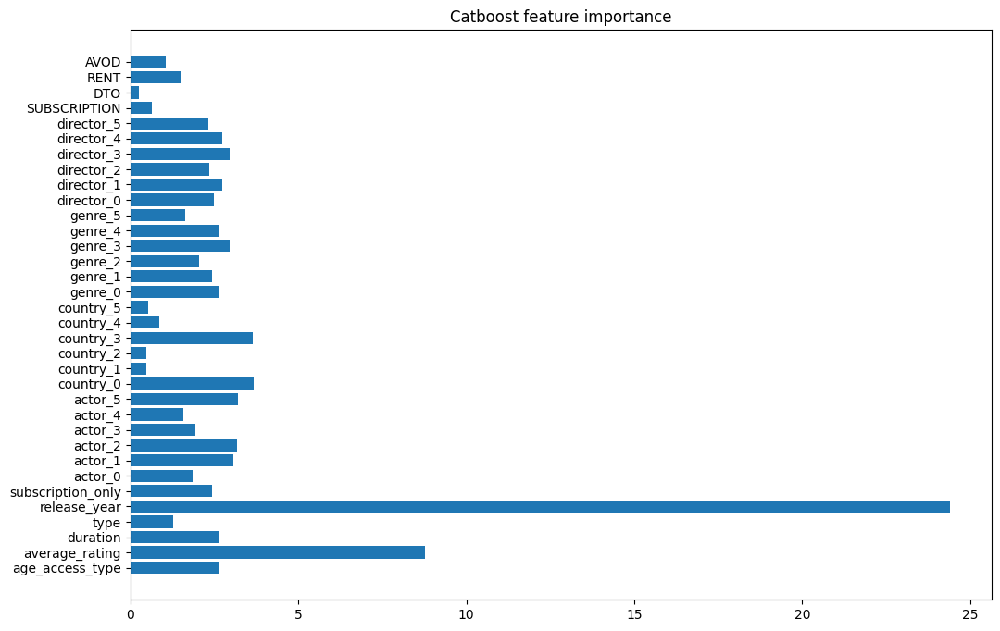

/tmp/ipykernel_2331/168675531.py:68: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test)
/tmp/ipykernel_2331/168675531.py:69: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_pred)


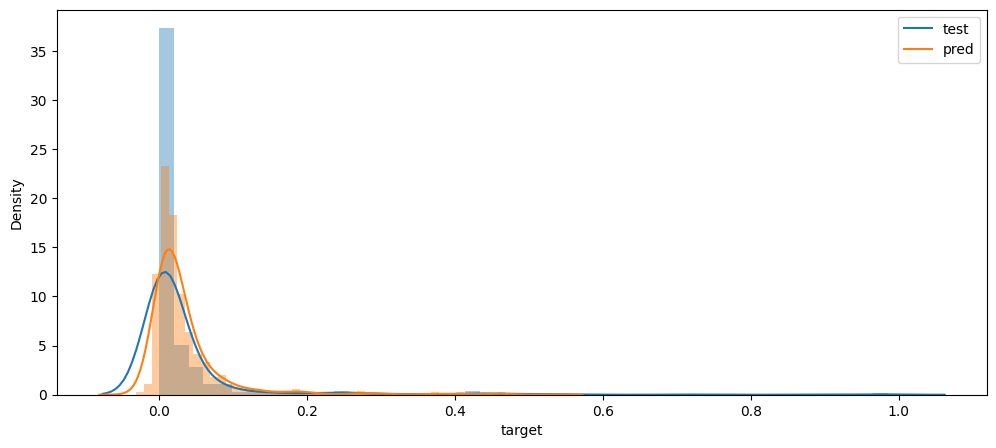

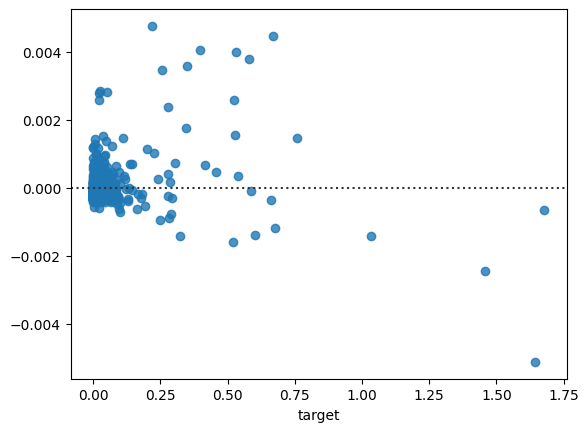

In [154]:
calc_metrics(y_test, y_pred, X)
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')
draw_residuals(y_test, y_pred, save_fig=False)

In [155]:
len(y_pred[y_pred <= 0])

82

# Min count 1

In [113]:
with open('dataset_2_1.pkl', 'rb') as f:
    df_pr = pickle.load(f)

In [114]:
df_pr.head()

,age_access_type,average_rating,duration,type,name,release_year,target,subscription_only,uid,actor_0,...,director_0,director_1,director_2,director_3,director_4,director_5,SUBSCRIPTION,DTO,RENT,AVOD
0,18,4.00,15.607270,MOVIE,В поисках древнего артефакта,2019,0.000004,0,11ba66db-e941-4c3a-8da6-d8900e56f8c7,-0.030709,...,-0.005546,0.034927,0.179571,0.139724,0.066432,0.127680,1,1,1,0
1,18,6.99,15.145235,MOVIE,Прожарка Чарли Шина,2011,0.000354,1,3f30a2ef-53b7-40e3-954f-1bdfc38a6d17,0.033636,...,-0.139757,-0.044668,0.109483,0.156753,-0.002948,0.036343,1,0,0,0
2,18,6.00,15.145235,MOVIE,Прожарка Уильяма Шэтнера,2006,0.000064,1,cdfa700f-122d-41e5-b8dc-9c6813bab6d2,0.004407,...,-0.139757,-0.044668,0.109483,0.156753,-0.002948,0.036343,1,0,0,0
3,0,6.21,15.396549,MOVIE,Большое путешествие,2006,0.000003,1,d8b55146-dee5-4498-957c-5614414b48fb,-0.028783,...,-0.058414,-0.088417,0.085593,0.010822,-0.128328,0.077235,1,0,0,0
4,6,6.40,15.523889,MOVIE,Пламенное сердце,2022,0.009705,1,ba6bec1a-3aa9-48c7-aa65-908c21627a12,-0.034545,...,-0.063541,0.019863,0.107477,0.056392,0.063167,-0.011712,1,0,0,0


## 3_2

In [118]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT', 'release_year']
num_features = ['age_access_type', 'average_rating', 'duration',
               'actor_0', 'actor_1', 'actor_2', 'actor_3', 'actor_4', 'actor_5',
                'country_0','country_1', 'country_2','country_3', 'country_4', 'country_5',
                'genre_0', 'genre_1', 'genre_2', 'genre_3', 'genre_4', 'genre_5',
                'director_0', 'director_1', 'director_2', 'director_3', 'director_4']

In [119]:
df_pr[cat_features]

,type,subscription_only,SUBSCRIPTION,AVOD,DTO,RENT,release_year
0,MOVIE,0,1,0,1,1,2019
1,MOVIE,1,1,0,0,0,2011
2,MOVIE,1,1,0,0,0,2006
3,MOVIE,1,1,0,0,0,2006
4,MOVIE,1,1,0,0,0,2022
...,...,...,...,...,...,...,...
9478,SERIAL,0,1,0,1,0,2015
9479,SERIAL,1,1,0,0,0,2022
9480,SERIAL,0,1,1,0,0,2020
9481,SERIAL,1,1,0,0,0,2020


In [120]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

In [121]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        )
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


## Training

In [122]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features,
    'iterations': 10000, 
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=50,
    verbose=100,
    plot=False
)

Learning rate set to 0.017502
0:	learn: 0.0426953	test: 0.0483676	best: 0.0483676 (0)	total: 5.67ms	remaining: 56.7s
100:	learn: 0.0339298	test: 0.0400219	best: 0.0400219 (100)	total: 442ms	remaining: 43.3s
200:	learn: 0.0316311	test: 0.0385061	best: 0.0385061 (200)	total: 899ms	remaining: 43.8s
300:	learn: 0.0305660	test: 0.0381202	best: 0.0381202 (300)	total: 1.34s	remaining: 43.1s
400:	learn: 0.0297967	test: 0.0378114	best: 0.0377981 (394)	total: 1.77s	remaining: 42.3s
500:	learn: 0.0293609	test: 0.0376264	best: 0.0376108 (496)	total: 2.18s	remaining: 41.4s
600:	learn: 0.0288780	test: 0.0374702	best: 0.0374699 (599)	total: 2.62s	remaining: 40.9s
700:	learn: 0.0284769	test: 0.0372630	best: 0.0372390 (694)	total: 3.05s	remaining: 40.4s
800:	learn: 0.0281013	test: 0.0371323	best: 0.0371320 (790)	total: 3.49s	remaining: 40.1s
900:	learn: 0.0277542	test: 0.0370600	best: 0.0370482 (890)	total: 3.94s	remaining: 39.8s
1000:	learn: 0.0273812	test: 0.0369067	best: 0.0368684 (991)	total: 4.36s

In [47]:
# cat_model = cat.CatBoostRegressor(**cat_params)
# cat_model.load_model('3')

In [125]:
cat_model.save_model('3_2')

In [123]:
y_pred = cat_model.predict(X_test)

In [124]:
calc_metrics(y_test, y_pred, X)

*** VAL **: 
MSE:   0.012487319197794089
RMSE:  0.11174667421357151
R2:    0.34424655106650515
MAE:   0.036257385158630986
MedAE: 0.012061656438094485
Adj_R2:  0.3418867270546784
------------------------------


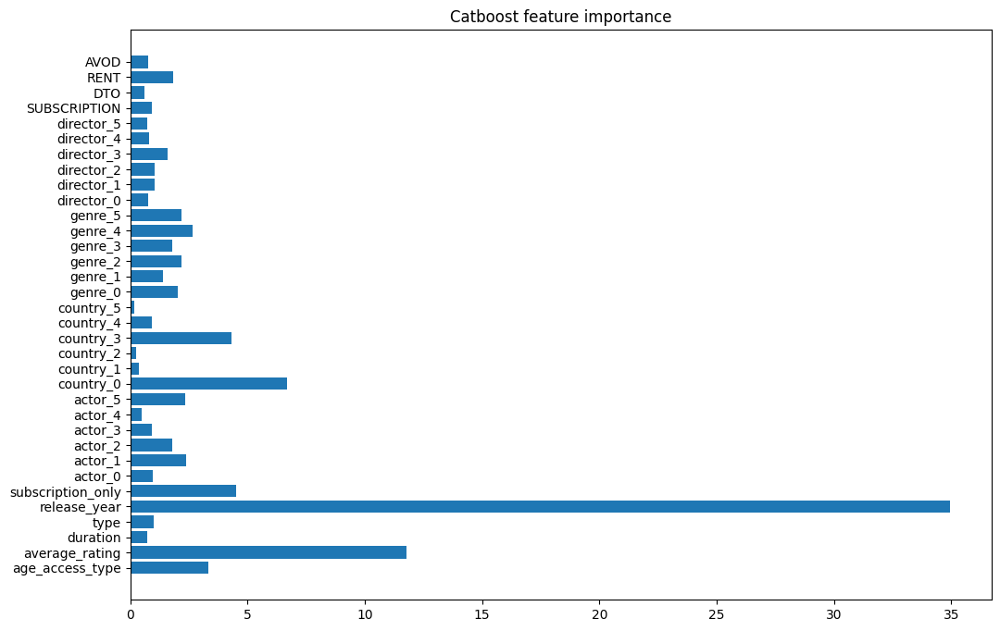

In [126]:
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')

/tmp/ipykernel_2331/168675531.py:68: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test)
/tmp/ipykernel_2331/168675531.py:69: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_pred)


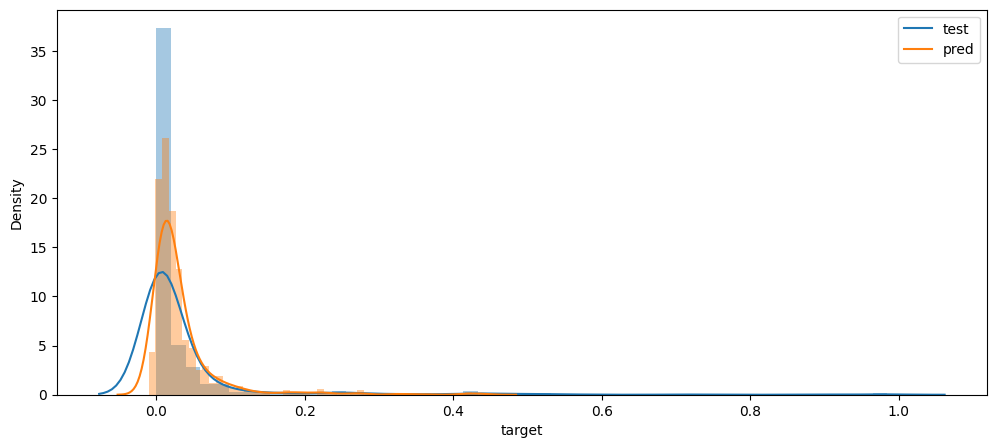

In [127]:
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')

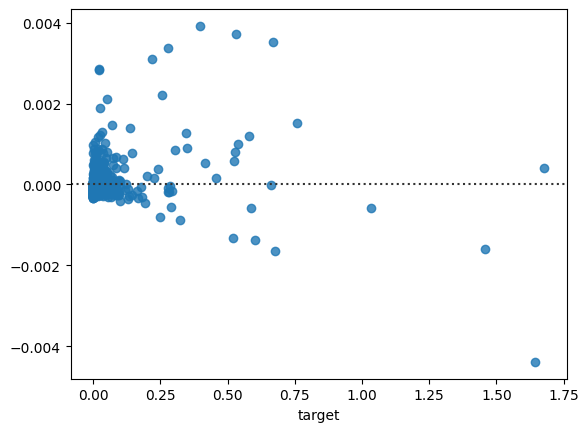

In [128]:
draw_residuals(y_test, y_pred, save_fig=False)

In [129]:
len(y_pred[y_pred <= 0])

42

### 3_2_1 drop release_year

In [130]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT']

In [131]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid', 'release_year'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

In [132]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        )
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


## Training

In [133]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features,
    'iterations': 10000, 
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=50,
    verbose=100,
    plot=False
)

Learning rate set to 0.017502
0:	learn: 0.0428711	test: 0.0485646	best: 0.0485646 (0)	total: 5.78ms	remaining: 57.8s
100:	learn: 0.0401918	test: 0.0460345	best: 0.0460345 (100)	total: 437ms	remaining: 42.9s
200:	learn: 0.0391443	test: 0.0452446	best: 0.0452362 (197)	total: 865ms	remaining: 42.1s
300:	learn: 0.0382483	test: 0.0445646	best: 0.0445646 (300)	total: 1.29s	remaining: 41.7s
400:	learn: 0.0376261	test: 0.0442400	best: 0.0442391 (399)	total: 1.73s	remaining: 41.3s
500:	learn: 0.0370692	test: 0.0438661	best: 0.0438524 (494)	total: 2.15s	remaining: 40.7s
600:	learn: 0.0364891	test: 0.0435586	best: 0.0435533 (595)	total: 2.57s	remaining: 40.2s
700:	learn: 0.0359374	test: 0.0433319	best: 0.0433317 (698)	total: 3s	remaining: 39.9s
800:	learn: 0.0354289	test: 0.0432066	best: 0.0431874 (795)	total: 3.45s	remaining: 39.7s
900:	learn: 0.0349808	test: 0.0429834	best: 0.0429834 (900)	total: 3.89s	remaining: 39.3s
1000:	learn: 0.0345681	test: 0.0428390	best: 0.0428212 (950)	total: 4.33s	re

In [134]:
cat_model.save_model('3_2_1')

In [137]:
y_pred = cat_model.predict(X_test)

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


In [138]:
calc_metrics(y_test, y_pred, X)

*** VAL **: 
MSE:   0.017315081485144997
RMSE:  0.13158678309444682
R2:    0.09072361948959273
MAE:   0.04542442071401627
MedAE: 0.021504049333942007
Adj_R2:  0.08754803259607558
------------------------------


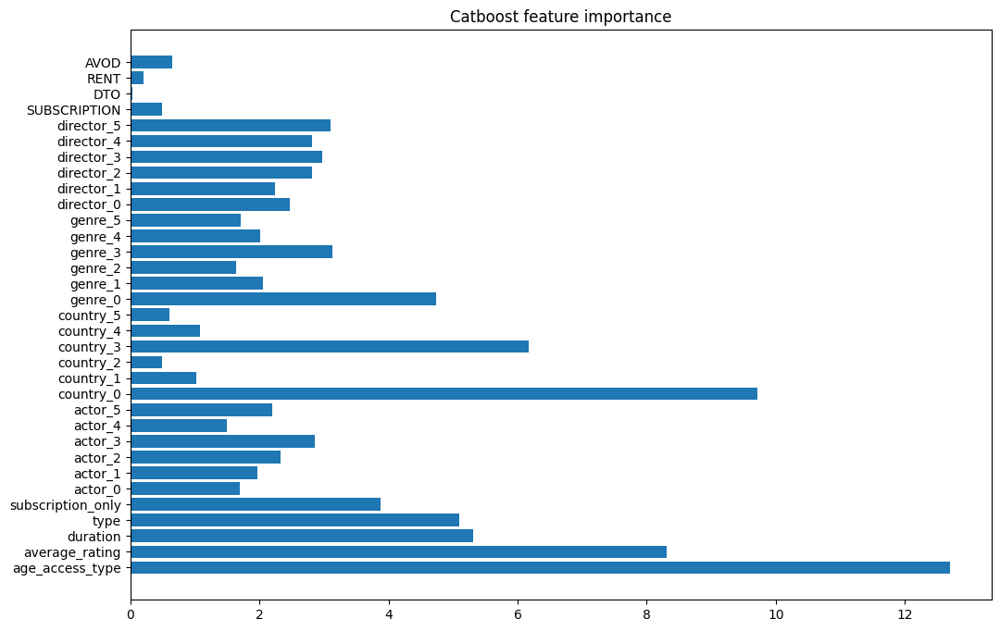

In [139]:
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')

/tmp/ipykernel_2331/168675531.py:68: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_test)
/tmp/ipykernel_2331/168675531.py:69: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(y_pred)


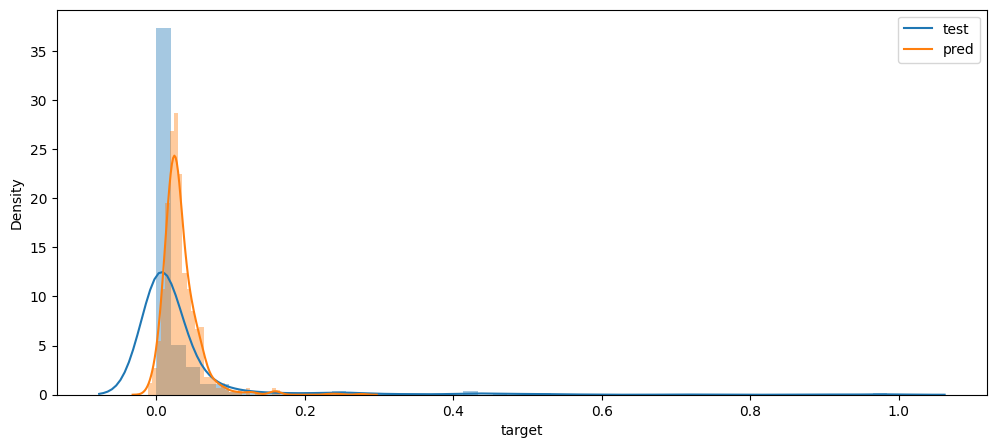

In [140]:
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')

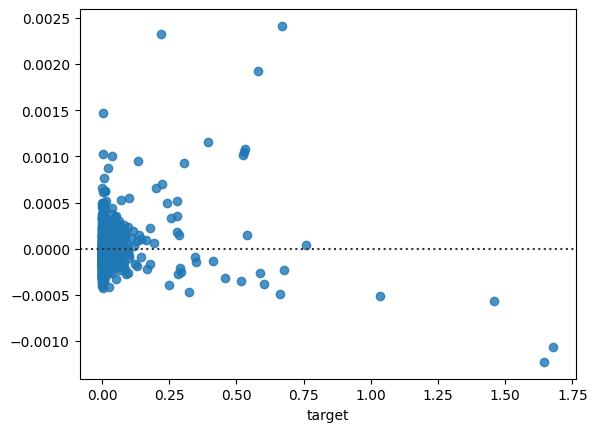

In [141]:
draw_residuals(y_test, y_pred, save_fig=False)

In [142]:
len(y_pred[y_pred <= 0])

15

## 3_2_finetuned Tuning

In [143]:
cat_features = ['type', 'subscription_only',
                'SUBSCRIPTION', 'AVOD', 'DTO', 'RENT', 'release_year']

In [144]:
MULTIPLIER = 100
X, y = df_pr.drop(['target', 'name', 'uid'], axis=1), df_pr['target']  * MULTIPLIER
y = target_transformer.transform(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.2, random_state=42, shuffle=True)
train_dataset = cat.Pool(X_train, y_train,
                         cat_features=cat_features,   
                        ) 
test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features,
                       )
val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features,
                      )

/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,


In [146]:
cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 100,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [ ]:
parameters_distr = {'depth': randint(5, 10),
                    'learning_rate': uniform(0.01, 0.3),
                    'iterations': randint(500, 10000),
                    'l2_leaf_reg':  uniform(0.01, 0.5)
                     }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, scoring='neg_mean_squared_error', 
                          cv=3, n_jobs=10, verbose=1)

grid.fit(X_train, y_train)

cat_model = grid.best_estimator_
cat_model.save_model('3_finetuned')

Fitting 3 folds for each of 10 candidates, totalling 30 fits


/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, embedding_features, pairs, weight,
/opt/conda/lib/python3.10/site-packages/catboost/core.py:1325: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  self._init_pool(data, label, cat_features, text_features, emb

0:	learn: 0.0409938	total: 159ms	remaining: 25m 28s
1:	learn: 0.0397802	total: 247ms	remaining: 19m 44s
2:	learn: 0.0385891	total: 317ms	remaining: 16m 53s
3:	learn: 0.0380140	total: 400ms	remaining: 16m
4:	learn: 0.0371607	total: 531ms	remaining: 16m 58s
5:	learn: 0.0364714	total: 931ms	remaining: 24m 48s
6:	learn: 0.0362657	total: 1.08s	remaining: 24m 37s
7:	learn: 0.0358215	total: 1.24s	remaining: 24m 49s
8:	learn: 0.0354820	total: 1.59s	remaining: 28m 16s
9:	learn: 0.0350749	total: 1.86s	remaining: 29m 47s
10:	learn: 0.0348418	total: 2.06s	remaining: 29m 58s
11:	learn: 0.0347257	total: 2.24s	remaining: 29m 51s
12:	learn: 0.0345979	total: 2.58s	remaining: 31m 42s
13:	learn: 0.0344932	total: 3.05s	remaining: 34m 50s
14:	learn: 0.0341599	total: 3.45s	remaining: 36m 43s
15:	learn: 0.0341372	total: 3.81s	remaining: 37m 59s
16:	learn: 0.0338901	total: 3.84s	remaining: 36m 5s
17:	learn: 0.0336959	total: 3.92s	remaining: 34m 49s
18:	learn: 0.0333715	total: 3.98s	remaining: 33m 27s
19:	lear

In [56]:
# best_cat = cat.CatBoostRegressor(**cat_params)      # parameters not required.
# best_cat.load_model('3_finetuned')

In [82]:
y_pred = cat_model.predict(X_test)

MAE 0.03367143740403902
R2 0.19489317778678694
Adj R2 0.1921199528308316


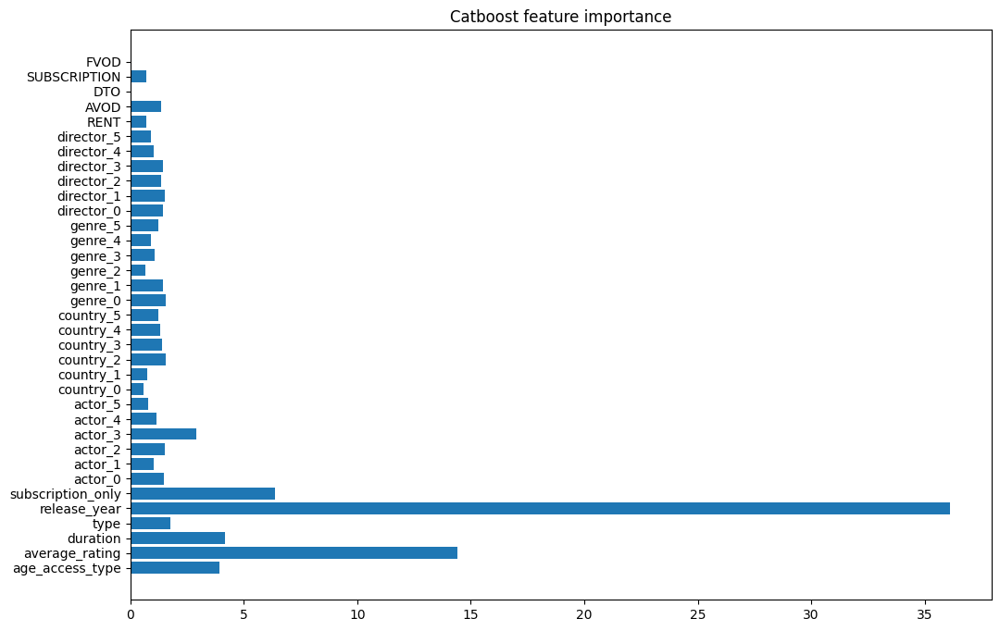

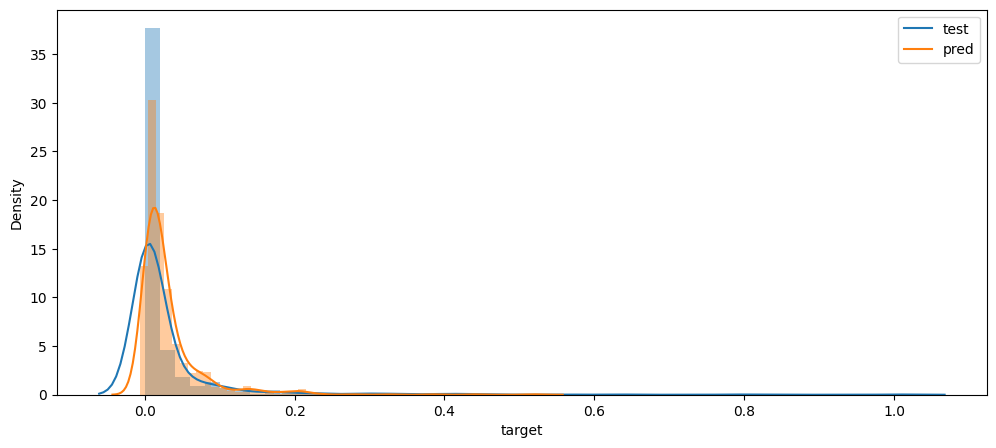

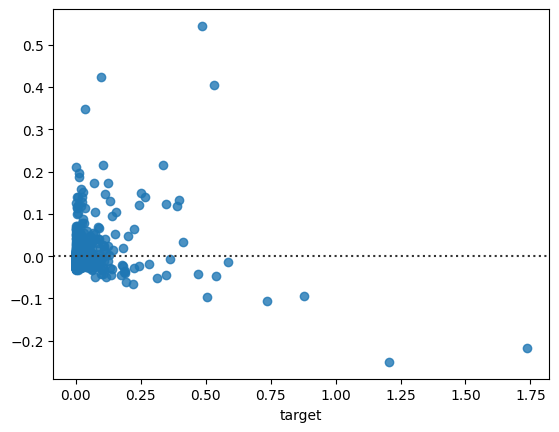

In [83]:
get_metrics(y_test, y_pred, X)
get_importance(train_dataset, cat_model, title='Catboost feature importance', save_fig=False, file_name='cat_feature_importance.png')
draw_target_distr(y_test, y_pred, save_fig=False, file_name='cat_distribution')
draw_residuals(y_test, y_pred, save_fig=False)

In [48]:
len(y_pred[y_pred <= 0])

71

In [87]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   0.0045609797537924405
RMSE:  0.06753502612565157
R2:    0.2360049275931868
MAE:   0.029449491515247908
MedAE: 0.012390380156556524
------------------------------


# 